# I. THE PROBLEM & GOAL

***Problem***

* Credit score cards are a common risk control method in the financial industry.
* It uses personal information and data submitted by credit card applicants to predict the probability of future defaults and credit card borrowings.
* The bank is able to decide whether to issue a credit card to the applicant. Credit scores can objectively quantify the magnitude of risk.
* This is important because it can be risky to issue credit cards to customers who are likely to default on their payments.

***Goal***

* Process the data and export training and testing datasets.

# II. DATA COLLECTION

## Import libraries

In [58]:
# Typical Data Science Stuff
import pandas as pd
from datetime import date
from datetime import timedelta
import datetime

# Automated EDA Tools
from dataprep.eda import create_report

# Encoders
import category_encoders as ce

# Visuals
import matplotlib.pyplot as plt
import seaborn as sns

# Splitting Into Train and Test Set
from sklearn.model_selection import train_test_split
from sklearn import preprocessing

import warnings
warnings.filterwarnings('ignore')

## Load data

In [59]:
data = pd.read_csv('application_record.csv', encoding = 'utf-8') 
record = pd.read_csv('credit_record.csv', encoding = 'utf-8')

In [60]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 438557 entries, 0 to 438556
Data columns (total 18 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   ID                   438557 non-null  int64  
 1   CODE_GENDER          438557 non-null  object 
 2   FLAG_OWN_CAR         438557 non-null  object 
 3   FLAG_OWN_REALTY      438557 non-null  object 
 4   CNT_CHILDREN         438557 non-null  int64  
 5   AMT_INCOME_TOTAL     438557 non-null  float64
 6   NAME_INCOME_TYPE     438557 non-null  object 
 7   NAME_EDUCATION_TYPE  438557 non-null  object 
 8   NAME_FAMILY_STATUS   438557 non-null  object 
 9   NAME_HOUSING_TYPE    438557 non-null  object 
 10  DAYS_BIRTH           438557 non-null  int64  
 11  DAYS_EMPLOYED        438557 non-null  int64  
 12  FLAG_MOBIL           438557 non-null  int64  
 13  FLAG_WORK_PHONE      438557 non-null  int64  
 14  FLAG_PHONE           438557 non-null  int64  
 15  FLAG_EMAIL       

* ID:                   Client number	
* CODE_GENDER:	        Gender	
* FLAG_OWN_CAR:	        Is there a car	
* FLAG_OWN_REALTY:	    Is there a property	
* CNT_CHILDREN:	        Number of children	
* AMT_INCOME_TOTAL:	    Annual income	
* NAME_INCOME_TYPE:	    Income category	
* NAME_EDUCATION_TYPE:	Education level	
* NAME_FAMILY_STATUS:	Marital status	
* NAME_HOUSING_TYPE:    Way of living	
* DAYS_BIRTH:	        Birthday (Count backwards from current day (0), -1 means yesterday)
* DAYS_EMPLOYED:	    Start date of employment (Count backwards from current day(0). If positive, it means the person currently unemployed)
* FLAG_MOBIL:	        Is there a mobile phone	
* FLAG_WORK_PHONE:	    Is there a work phone	
* FLAG_PHONE:	        Is there a phone	
* FLAG_EMAIL:	        Is there an email	
* OCCUPATION_TYPE:	    Occupation	
* CNT_FAM_MEMBERS:	    Family size

In [61]:
record.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 3 columns):
 #   Column          Non-Null Count    Dtype 
---  ------          --------------    ----- 
 0   ID              1048575 non-null  int64 
 1   MONTHS_BALANCE  1048575 non-null  int64 
 2   STATUS          1048575 non-null  object
dtypes: int64(2), object(1)
memory usage: 24.0+ MB


* ID:	            Client number	
* MONTHS_BALANCE:	Record month (The month of the extracted data is the starting point, backwards, 
    0 is the current month, -1 is the previous month, and so on)
* STATUS:	        Status (0: 1-29 days past due 1: 30-59 days past due 2: 60-89 days overdue 
    3: 90-119 days overdue 4: 120-149 days overdue 5: Overdue or bad debts, write-offs for more 
    than 150 days C: paid off that month X: No loan for the month)

# III. DATA PREPROCESSING

#### Merge datasets

In [62]:
df = data.merge(record, on='ID', how='inner')

In [63]:
df

,ID,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,MONTHS_BALANCE,STATUS
0,5008804,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,1,0,0,NaN,2.0,0,C
1,5008804,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,1,0,0,NaN,2.0,-1,C
2,5008804,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,1,0,0,NaN,2.0,-2,C
3,5008804,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,1,0,0,NaN,2.0,-3,C
4,5008804,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,1,0,0,NaN,2.0,-4,C
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
777710,5150337,M,N,Y,0,112500.0,Working,Secondary / secondary special,Single / not married,Rented apartment,-9188,-1193,1,0,0,0,Laborers,1.0,-9,0
777711,5150337,M,N,Y,0,112500.0,Working,Secondary / secondary special,Single / not married,Rented apartment,-9188,-1193,1,0,0,0,Laborers,1.0,-10,2
777712,5150337,M,N,Y,0,112500.0,Working,Secondary / secondary special,Single / not married,Rented apartment,-9188,-1193,1,0,0,0,Laborers,1.0,-11,1
777713,5150337,M,N,Y,0,112500.0,Working,Secondary / secondary special,Single / not married,Rented apartment,-9188,-1193,1,0,0,0,Laborers,1.0,-12,0


#### Function to calculate birthday and age

In [64]:
def calc_day_of_birth (day_num):
    today = date.today() 
    birthDay = (today + timedelta(days=day_num)).strftime('%Y-%m-%d')
    return birthDay

In [65]:
def calc_day_of_employed(day_num):
    today = date.today() 
    employedDay = (today + timedelta(days=day_num)).strftime('%Y-%m-%d')
    result = 0
    if employedDay > date.today().strftime('%Y-%m-%d') :
         result = 0
    else:
         result = employedDay
    return result

In [66]:
def calculate_age(born):
    born = datetime.datetime.strptime(born, '%Y-%m-%d')
    today = date.today()
    return today.year - born.year - ((today.month, today.day) < (born.month, born.day))

## 1 Data cleaning

In [67]:
#get the day of birth for each person   
df['Birth_day'] = df['DAYS_BIRTH'].apply(calc_day_of_birth)
#calculate age 
df['Age'] = df['Birth_day'].apply(calculate_age)

* Drop unnecessary columns

In [68]:
df = df.drop(['ID','DAYS_BIRTH','MONTHS_BALANCE','DAYS_EMPLOYED','Birth_day','FLAG_MOBIL'],axis=1)

* Rename columns

In [69]:
df.rename(columns={'CODE_GENDER':'Gender',
                   'FLAG_OWN_CAR':'Own_car',
                   'FLAG_OWN_REALTY':'Own_property',
                   'CNT_CHILDREN':'Num_children',
                   'AMT_INCOME_TOTAL':'Income',
                   'NAME_INCOME_TYPE':'Income_type',
                   'NAME_EDUCATION_TYPE':'Education_type',
                   'NAME_FAMILY_STATUS':'Family_status',
                   'NAME_HOUSING_TYPE':'Housing_type',
                   'FLAG_WORK_PHONE':'Work_phone',
                   'FLAG_PHONE':'Phone',
                   'FLAG_EMAIL':'Email',
                   'OCCUPATION_TYPE':'Occupation_type',
                   'CNT_FAM_MEMBERS':'Num_family_members'},inplace=True)

* Check duplicate data
* Check missing value
* Dealing with missing value

In [70]:
df = df.drop_duplicates()

In [71]:
df.isnull().sum()[df.isnull().sum()>0]

Occupation_type    7537
dtype: int64

In [72]:
df['Occupation_type'].fillna('Others', inplace=True)

## 2 Response Variable

* Generally, users in risk should be in 3%, thus I choose users who overdue for more than 60 days as target risk users. Those samples are marked as '1', else are '0'.

In [73]:
#Function to get the label for the STATUS column
def get_label_for_data(status):
    if status in (2,3,4,5):
        return 1 # Risky
    else:
        return 0 # Not Risky

In [74]:
# replacing the value of C,X to numeric value 
df['STATUS'].replace({'C': 6, 'X' : 7}, inplace=True)
df['STATUS'] = df['STATUS'].astype(int)

In [75]:
df['Target'] = df['STATUS'].apply(get_label_for_data)

In [76]:
df['Target'].value_counts()

0    24653
1      839
Name: Target, dtype: int64

In [77]:
df.drop(['STATUS'],axis=1,inplace=True)

## 3 Preprocessing

### 3.1 Preparing data

In [78]:
df

,Gender,Own_car,Own_property,Num_children,Income,Income_type,Education_type,Family_status,Housing_type,Work_phone,Phone,Email,Occupation_type,Num_family_members,Age,Target
0,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,1,0,0,Others,2.0,32,0
13,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,1,0,0,Others,2.0,32,0
14,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,1,0,0,Others,2.0,32,0
15,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,1,0,0,Others,2.0,32,0
31,M,Y,Y,0,112500.0,Working,Secondary / secondary special,Married,House / apartment,0,0,0,Security staff,2.0,58,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
777690,F,N,Y,0,157500.0,Pensioner,Higher education,Married,House / apartment,0,1,1,Medicine staff,2.0,33,0
777691,F,N,Y,0,283500.0,Working,Secondary / secondary special,Married,House / apartment,0,0,0,Sales staff,2.0,49,1
777701,M,N,Y,0,112500.0,Working,Secondary / secondary special,Single / not married,Rented apartment,0,0,0,Laborers,1.0,25,0
777711,M,N,Y,0,112500.0,Working,Secondary / secondary special,Single / not married,Rented apartment,0,0,0,Laborers,1.0,25,1


In [79]:
column_data = df.columns
for col in column_data:
    label = preprocessing.LabelEncoder()
    df[col] = label.fit_transform(df[col].values)

In [80]:
# Use target encoder to encode the non-numerical columns
# Define the target encoder with smoothing to avoid overfitting
encoder = ce.TargetEncoder(cols=["Income_type", "Education_type", "Family_status", "Housing_type", "Occupation_type"], smoothing=0.2)

In [81]:
df = encoder.fit_transform(df, df["Target"])

In [82]:
df

,Gender,Own_car,Own_property,Num_children,Income,Income_type,Education_type,Family_status,Housing_type,Work_phone,Phone,Email,Occupation_type,Num_family_members,Age,Target
0,1,1,1,0,226,0.028561,0.032812,0.022543,0.035990,1,0,0,0.034364,1,12,0
13,1,1,1,0,226,0.028561,0.032812,0.022543,0.035990,1,0,0,0.034364,1,12,0
14,1,1,1,0,226,0.028561,0.032812,0.022543,0.035990,1,0,0,0.034364,1,12,0
15,1,1,1,0,226,0.028561,0.032812,0.022543,0.035990,1,0,0,0.034364,1,12,0
31,1,1,1,0,77,0.028561,0.032083,0.030788,0.032052,0,0,0,0.035363,1,38,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
777690,0,0,1,0,120,0.047033,0.032812,0.030788,0.032052,0,1,1,0.027638,1,13,0
777691,0,0,1,0,195,0.028561,0.032083,0.030788,0.032052,0,0,0,0.022635,1,29,1
777701,1,0,1,0,77,0.028561,0.032083,0.042885,0.035990,0,0,0,0.031840,0,5,0
777711,1,0,1,0,77,0.028561,0.032083,0.042885,0.035990,0,0,0,0.031840,0,5,1


### 3.2 EDA

#### Correlation heatmap

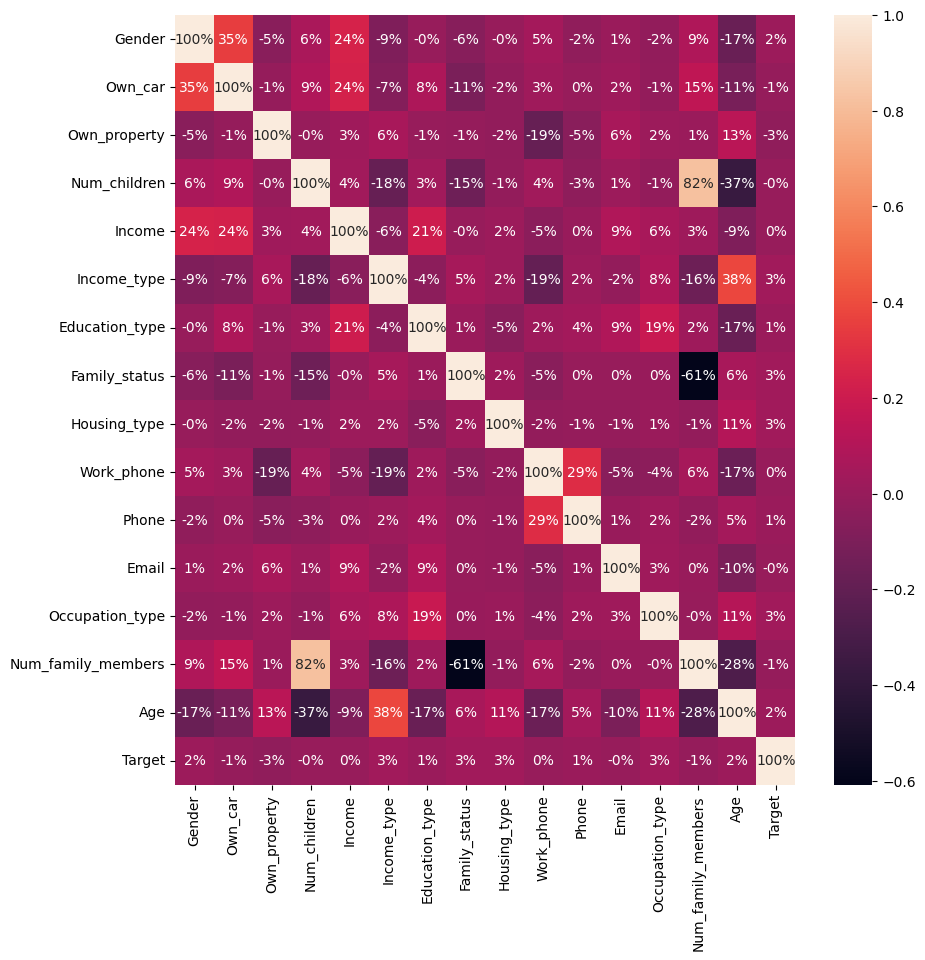

In [83]:
plt.figure(figsize=(10,10))
sns.heatmap(df.corr(method='spearman'), annot=True, fmt='.0%')
plt.show()

In [84]:
df.drop(['Num_family_members'],axis=1,inplace=True)

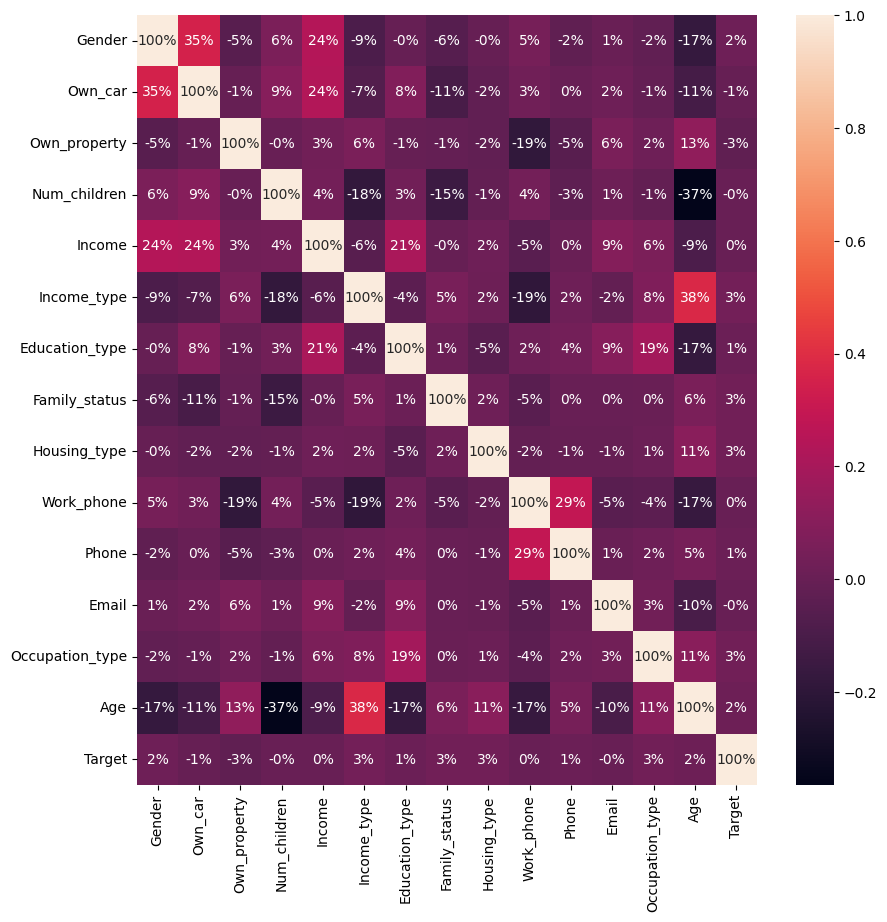

In [85]:
plt.figure(figsize=(10,10))
sns.heatmap(df.corr(method='spearman'), annot=True, fmt='.0%')
plt.show()

#### Distribution

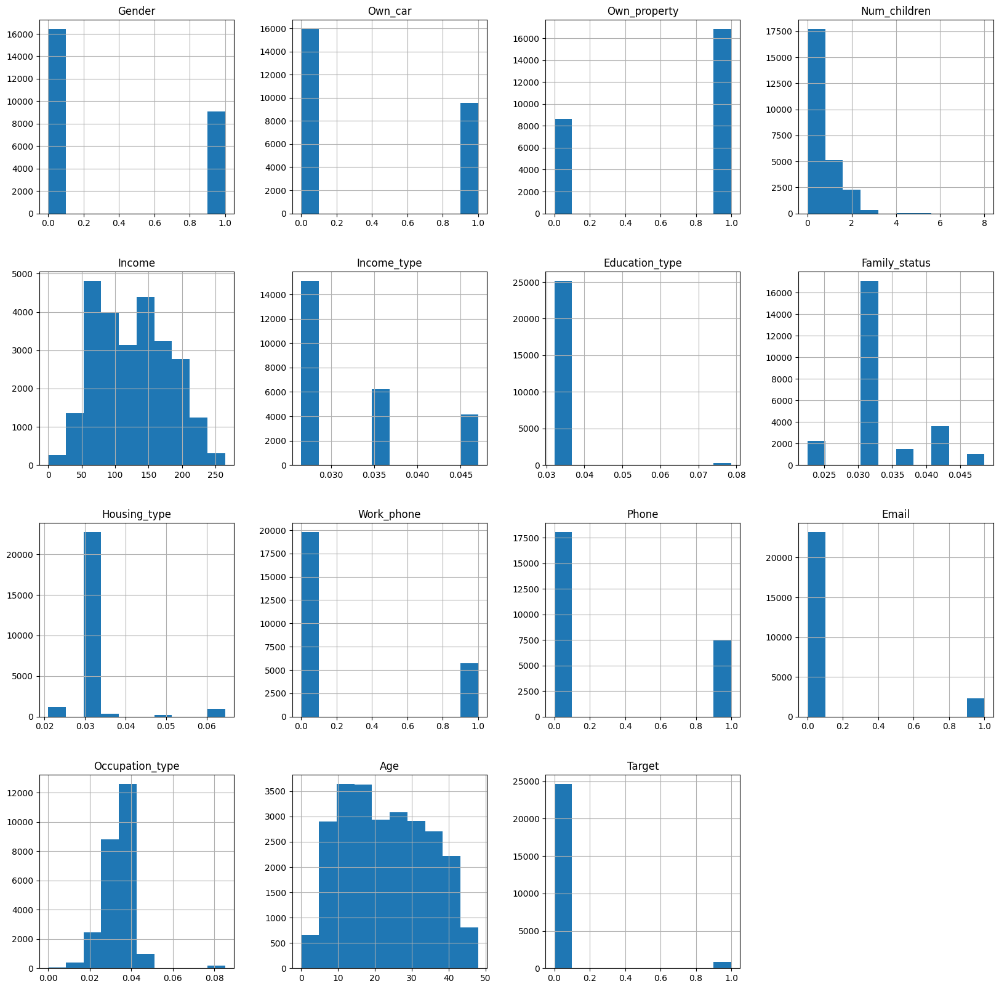

In [86]:
# Show the distribution of values in each column of the dataframe
df.hist(figsize=(20, 20))
plt.show()

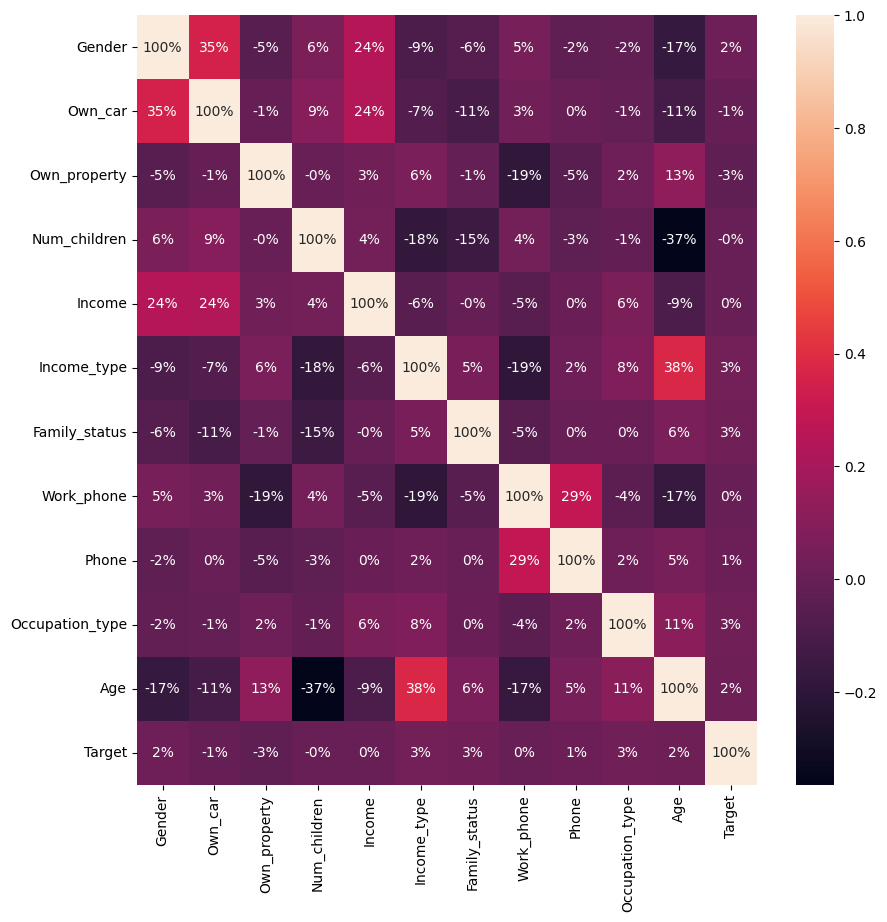

In [87]:
df.drop(['Education_type','Housing_type','Email'],axis=1,inplace=True)
plt.figure(figsize=(10,10))
sns.heatmap(df.corr(method='spearman'), annot=True, fmt='.0%')
plt.show()

#### Interactive

  0%|          | 0/1415 [00:00<?, ?it/s]


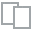
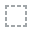
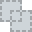
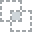
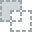
...
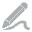
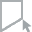
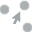
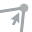
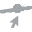

In [88]:
report = create_report(df)
report.show()

## 4 Make train/test datasets

In [89]:
# Split the dataset into training and testing sets
train, test = train_test_split(df, test_size=0.2, random_state=42)

# Save the training and testing sets as CSV files
train.to_csv('train.csv', index=False)
test.to_csv('test.csv', index=False)